In [3]:
import torch
import torch.nn as nn

import matplotlib.pyplot as plt
from matplotlib import collections  as mc

from IPython.display import clear_output
from tqdm.notebook import tqdm as tqdm

from sklearn import datasets

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

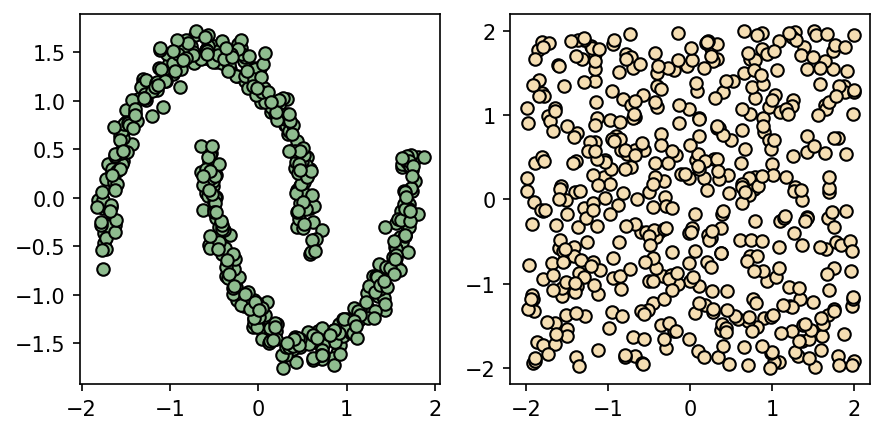

In [4]:
class ToyDatasets:
    def __init__(self, size=2,noise=0.05, random_state=0):
        self.size = size
        self.noise = noise
        self.random_state = random_state


    def sampleP(self, n_samples):
        samples,_ = datasets.make_moons(n_samples=n_samples, noise=self.noise, random_state=self.random_state)
        samples = torch.tensor(samples.astype('float32'))
        # standardize to keep a similar scale
        mean = torch.mean(samples, dim=0)
        std = torch.std(samples, dim=0)
        samples_standardized = (samples - mean) / std

        return samples_standardized

    def sampleQ(self, n_samples):
        samples = torch.rand(n_samples, 2) * self.size*2 - self.size
        return samples
    
    

torch.manual_seed(0)
dataset = ToyDatasets()
X = dataset.sampleP(512)
Y = dataset.sampleQ(512)

fig, axes = plt.subplots(1, 2, figsize=(6,3), dpi=150, sharex=False, sharey=False)
axes[0].scatter(X[:,0], X[:, 1], c='darkseagreen', edgecolors='black')
axes[1].scatter(Y[:,0], Y[:, 1], c='wheat', edgecolors='black')
fig.tight_layout()

In [5]:
def weak_sq_cost(X, T_XZ, gamma):
    X = X.flatten(start_dim=1) # flatten all dimensions except batch
    T_XZ = T_XZ.flatten(start_dim=2) # flatten all dimensions except batch and z

    l2 = (X[:,None] - T_XZ).square().sum(dim=2).mean()
    var = T_XZ.var(dim=1).sum(dim=1).mean()
    return l2 - 0.5 * gamma * var

def weak_kernel_cost(X, T_XZ, gamma):
    X = X.flatten(start_dim=1)
    T_XZ = T_XZ.flatten(start_dim=2)
    z_size = T_XZ.size(1)
    
    l2_dist = (X[:,None] - T_XZ).norm(dim=2).mean()
    kvar = .5 * torch.cdist(T_XZ, T_XZ).mean() * z_size / (z_size -1)
    return l2_dist - 0.5 * gamma * kvar

In [6]:
class Modelf(nn.Module):
    def __init__(self):
        super(Modelf, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(2, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 1),
        )

    def forward(self, x):
        return self.network(x)
    
class ModelT(nn.Module):
    def __init__(self):
        super(ModelT, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(2+2, 128), 
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 128),
            nn.ReLU(),
            nn.Linear(128, 2),
        )

    def forward(self, xz):
        return self.network(xz)

In [19]:
def train(model_T, model_f, optimizer_T, optimizer_f, max_steps, dataset, T_iters, batch_size,z_size,cost_function,XZ_fixed, X_fixed, Y_fixed,gamma=1.0,clearoutput=True):
    """
    Train the model_T and model_f using the given optimizers and cost function.

    Args:
    model_T: torch.nn.Module, the T model to train
    model_f: torch.nn.Module, the f model to train
    optimizer_T: torch.optim.Optimizer, the optimizer for model_T
    optimizer_f: torch.optim.Optimizer, the optimizer for model_f
    max_steps: int, the number of training steps to do
    dataset: torch.utils.data.Dataset, the dataset to sample from
    T_iters: int, the number of iterations to train model_T per step
    batch_size: int, the number of samples to draw from the dataset per step
    z_size: int, the number of noise vectors to sample per sample from the dataset
    cost_function: function, the cost function to use for training
    XZ_fixed: torch.Tensor, the fixed samples to use for plotting
    X_fixed: torch.Tensor, the fixed samples to use for plotting
    Y_fixed: torch.Tensor, the fixed samples to use for plotting
    gamma: float, the gamma parameter for the cost function
    clearoutput: bool, whether to clear the output after each step
    """
    for step in tqdm(range(max_steps)):
        
        # Optimize T
        model_T.train()
        model_f.eval()

        for _ in range(T_iters):
            X = dataset.sampleP(batch_size).to(DEVICE)
            Z = torch.randn(batch_size, z_size, 2).to(DEVICE)

            XZ = torch.cat((X[:,None].repeat(1,z_size,1), Z), dim=2)
            T_XZ = model_T(XZ)

            T_loss = cost_function(X, T_XZ, gamma) - model_f(T_XZ).mean()

            optimizer_T.zero_grad()
            T_loss.backward()
            optimizer_T.step()
        
        # Optimize f
        model_T.eval()
        model_f.train()

        X = dataset.sampleP(batch_size).to(DEVICE)
        Y = dataset.sampleQ(batch_size).to(DEVICE)
        Z = torch.randn(batch_size, z_size, 2).to(DEVICE)
        XZ = torch.cat((X[:,None].repeat(1,z_size,1), Z), dim=2)

        T_XZ = model_T(XZ)
        f_loss = model_f(T_XZ).mean() - model_f(Y).mean()
        
        optimizer_f.zero_grad()
        f_loss.backward()
        optimizer_f.step()
    
        if step % 1000 ==0 and step >= 5000: 
            #if(step < 9500 and clearoutput):
            if(clearoutput):
                clear_output(wait=True)
            print("Step", step)
            print("T_loss", T_loss.item())
            print("f_loss", f_loss.item())
            plot_results(gamma, XZ_fixed, X_fixed, Y_fixed, model_T,z_size)


def plot_results(gamma, XZ_fixed, X_fixed, Y_fixed, T,z_size):
    print('gamma={}'.format(gamma))
    fig, axes = plt.subplots(1, 4, figsize=(12,3), dpi=150, sharex=True, sharey=True)
    XZ_fixed = XZ_fixed.to(DEVICE)
    with torch.no_grad():
        T_XZ_fixed = T(XZ_fixed.flatten(start_dim=0, end_dim=1)).permute(1,0).reshape(-1,X_fixed.shape[0],z_size).permute(1,2,0).to('cpu').numpy()
        XZ_fixed = XZ_fixed.to('cpu').numpy()

    nb_lines = X_fixed.shape[0]//4
    lines = list(zip(XZ_fixed[:nb_lines,:,:2].reshape(-1,2), T_XZ_fixed[:nb_lines].reshape(-1,2)))
    axes[0].set_xlim(-2.5, 2.5); axes[0].set_ylim(-2.5, 2.5)

    lc = mc.LineCollection(lines, linewidths=0.5, color='black')
    axes[0].scatter(X_fixed[:nb_lines,0], X_fixed[:nb_lines, 1], c='darkseagreen', edgecolors='black', zorder=2, label=r'Input $x\sim\mu$')
    axes[1].add_collection(lc)
    axes[1].scatter(X_fixed[:nb_lines,0], X_fixed[:nb_lines, 1], c='darkseagreen', edgecolors='black', zorder=2, label=r'Input $x\sim\mu$')
    axes[1].scatter(T_XZ_fixed[:nb_lines].reshape(nb_lines*z_size,-1)[:,0], T_XZ_fixed[:nb_lines].reshape(nb_lines*z_size,-1)[:,1], c='tomato', edgecolors='black', zorder=3, label=r'Mapped $T(x,z)$')
    axes[2].scatter(T_XZ_fixed[:,0,0], T_XZ_fixed[:,0,1], c='tomato', edgecolors='black', label=r'Mapped $T(x,z)$')
    axes[3].scatter(Y_fixed[:,0], Y_fixed[:, 1], c='wheat', edgecolors='black', label=r'Target $y\sim\nu$')
    axes[0].legend(loc='upper right');axes[1].legend(loc='upper right'); axes[2].legend(loc='upper right'); axes[3].legend(loc='upper right')
    fig.tight_layout()
    plt.show()

In [8]:
torch.manual_seed(1)

z_size = 4

# Fixed data for plotting at every iterations
X_fixed = dataset.sampleP(512)
Y_fixed = dataset.sampleQ(512)
Z_fixed = torch.randn(512, z_size, 2)
X_fixed_expanded = X_fixed[:, None, :].repeat(1, z_size, 1)
XZ_fixed = torch.cat((X_fixed_expanded, Z_fixed), dim=2).float()

# Vizualise oscillations of quadratic cost:

Step 9450
T_loss 0.3041483759880066
f_loss 0.09400265663862228
gamma=1.0


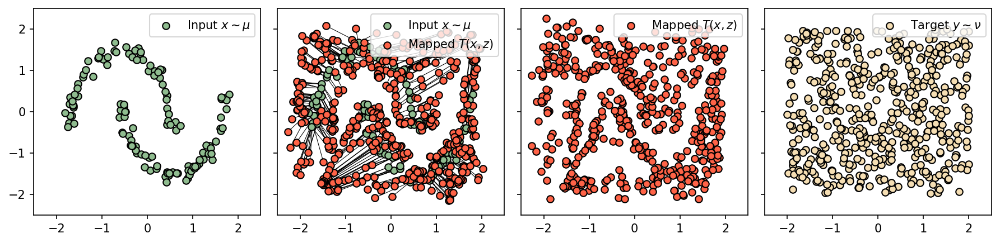

Step 9500
T_loss 0.30487051606178284
f_loss 0.005182389169931412
gamma=1.0


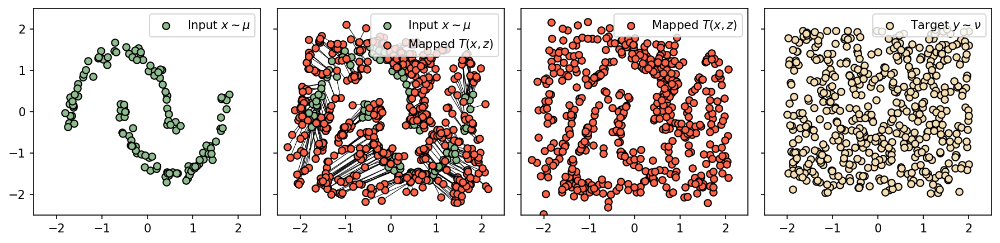

Step 9550
T_loss 0.3430052697658539
f_loss -0.02455008402466774
gamma=1.0


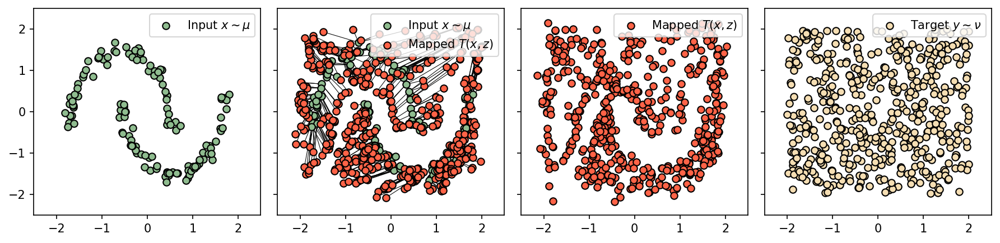

Step 9600
T_loss 0.370772123336792
f_loss -0.09071210026741028
gamma=1.0


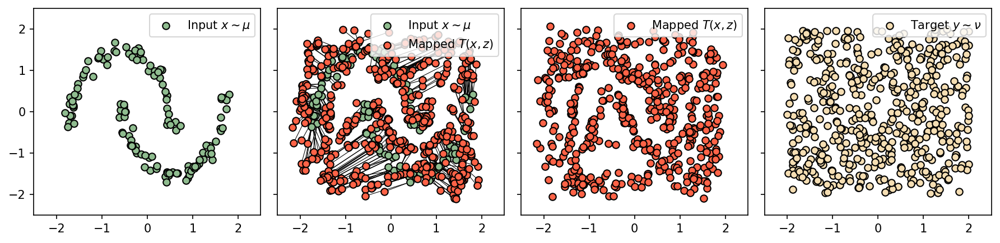

Step 9650
T_loss 0.31967201828956604
f_loss -0.09134078025817871
gamma=1.0


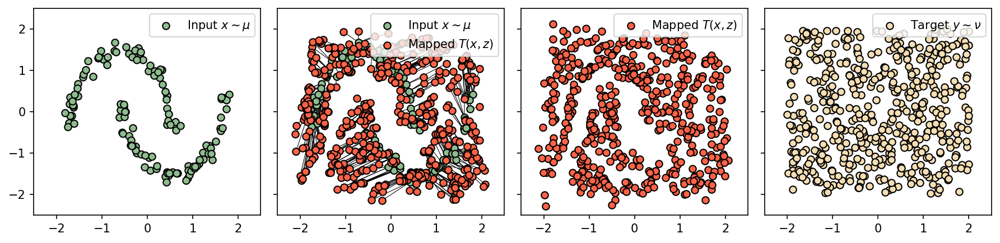

Step 9700
T_loss 0.3487671911716461
f_loss 0.05650773644447327
gamma=1.0


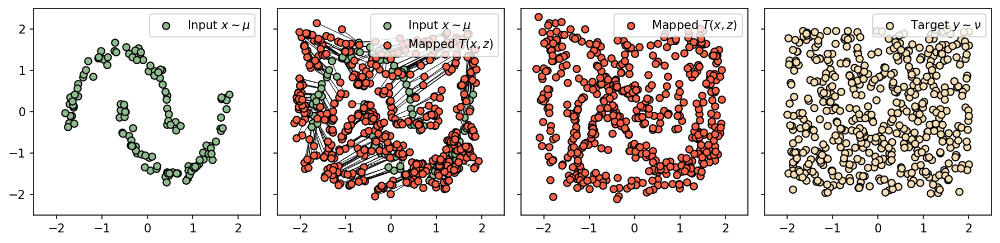

Step 9750
T_loss 0.30078038573265076
f_loss -0.01176697202026844
gamma=1.0


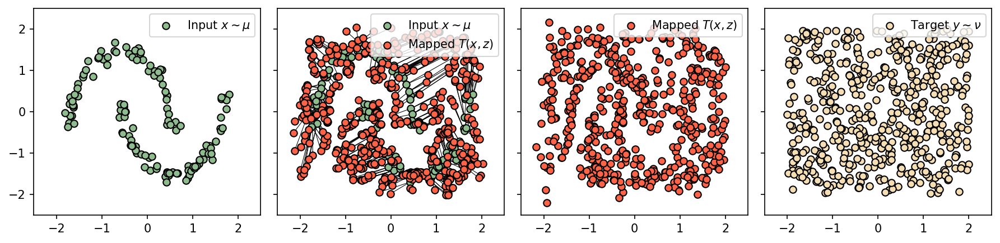

Step 9800
T_loss 0.36468249559402466
f_loss -0.07652079313993454
gamma=1.0


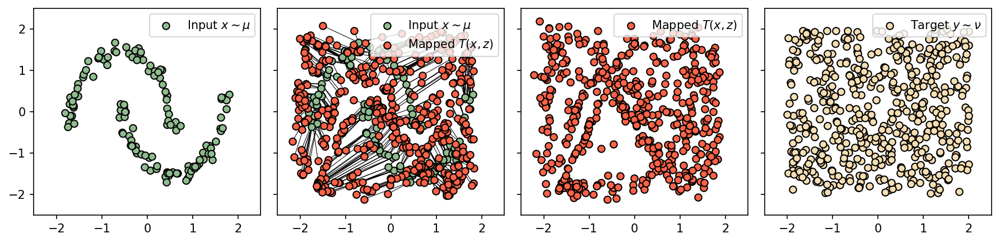

Step 9850
T_loss 0.2860812246799469
f_loss 0.08914422988891602
gamma=1.0


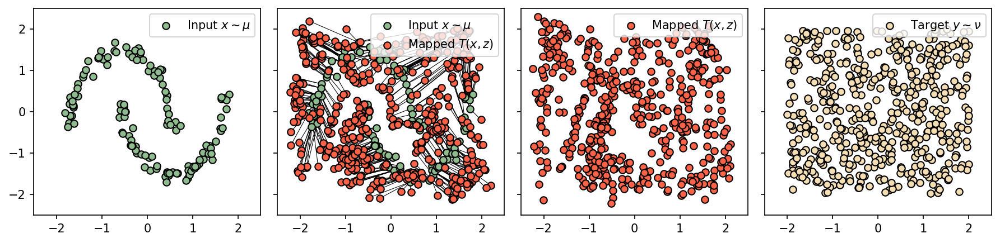

Step 9900
T_loss 0.27970221638679504
f_loss 0.007568463683128357
gamma=1.0


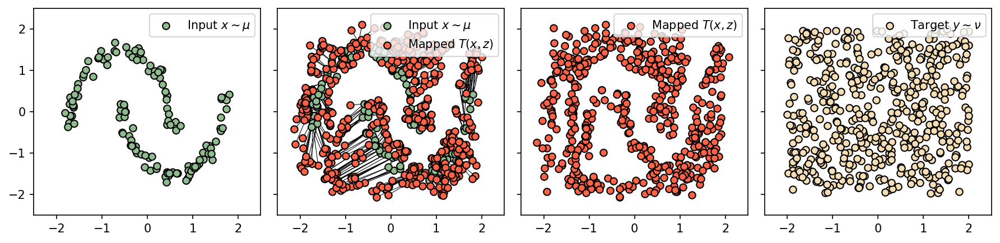

Step 9950
T_loss 0.30645251274108887
f_loss 0.09007768332958221
gamma=1.0


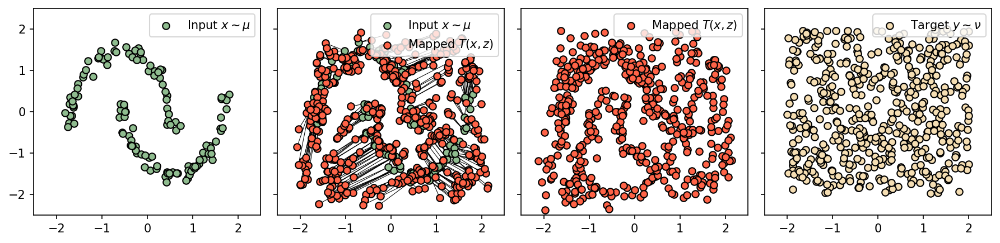

In [37]:
print("QUADRATIC COST")
torch.manual_seed(1)

model_T = ModelT().to(DEVICE)
model_f = Modelf().to(DEVICE)

optim_T = torch.optim.Adam(model_T.parameters(), lr=1e-4, weight_decay=1e-10)
optim_f = torch.optim.Adam(model_f.parameters(), lr=1e-4, weight_decay=1e-10)

train(model_T, model_f, optim_T, optim_f,max_steps=10000, dataset=dataset, T_iters=10, batch_size=64, z_size=z_size, cost_function=weak_sq_cost, XZ_fixed=XZ_fixed, X_fixed=X_fixed, Y_fixed=Y_fixed,gamma=1.0)

Step 9450
T_loss 0.8738946914672852
f_loss 0.055142104625701904
gamma=1.0


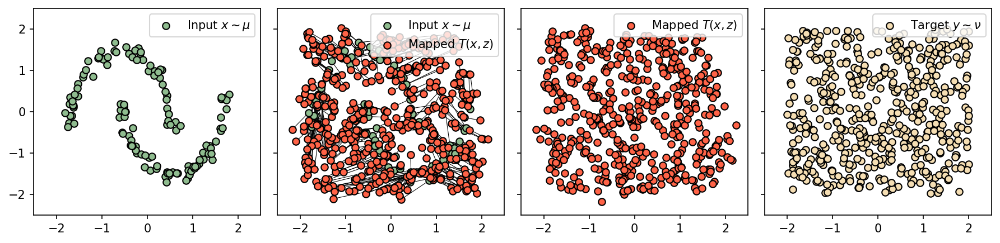

Step 9500
T_loss 0.8951232433319092
f_loss -0.015644848346710205
gamma=1.0


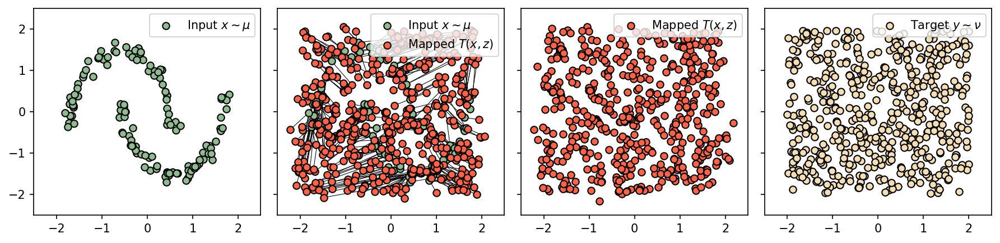

Step 9550
T_loss 0.8802801370620728
f_loss 0.00844496488571167
gamma=1.0


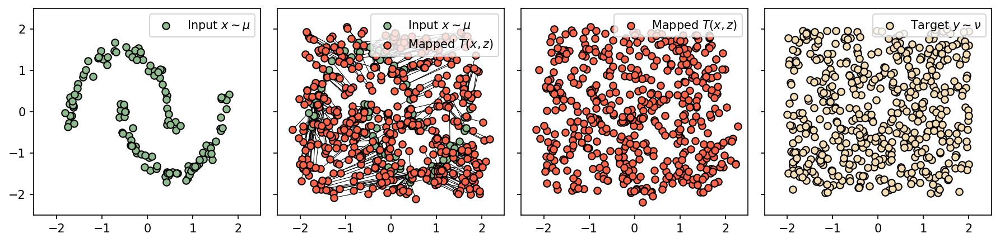

Step 9600
T_loss 0.8824912309646606
f_loss 0.05674624443054199
gamma=1.0


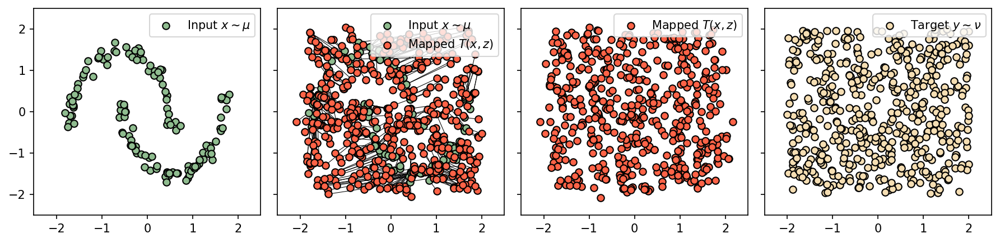

Step 9650
T_loss 0.892207145690918
f_loss -0.008811116218566895
gamma=1.0


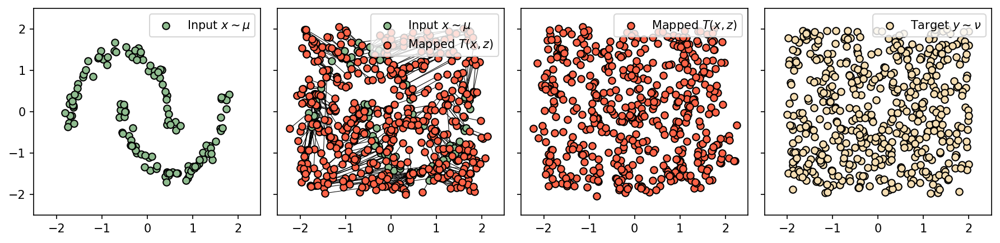

Step 9700
T_loss 0.8671455383300781
f_loss -0.08142399787902832
gamma=1.0


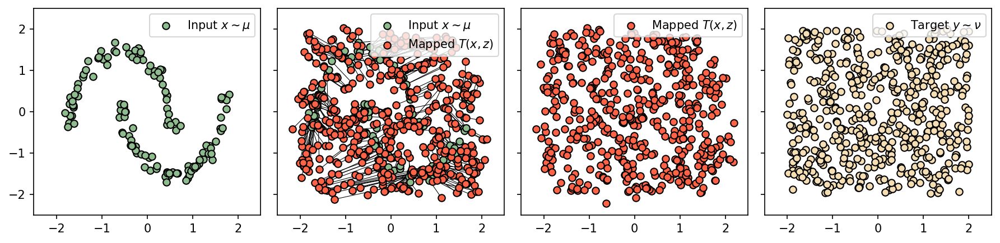

Step 9750
T_loss 0.8801615238189697
f_loss -0.022706568241119385
gamma=1.0


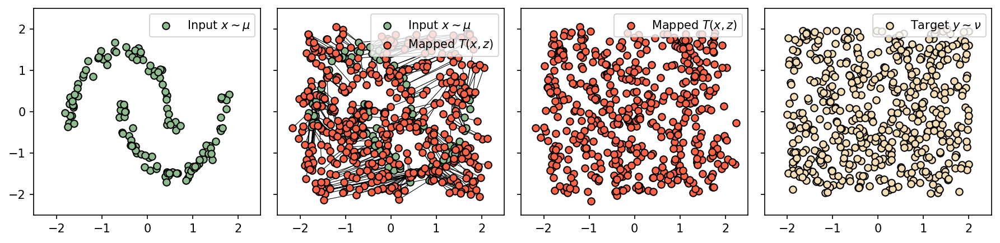

Step 9800
T_loss 0.845401406288147
f_loss 0.07672011852264404
gamma=1.0


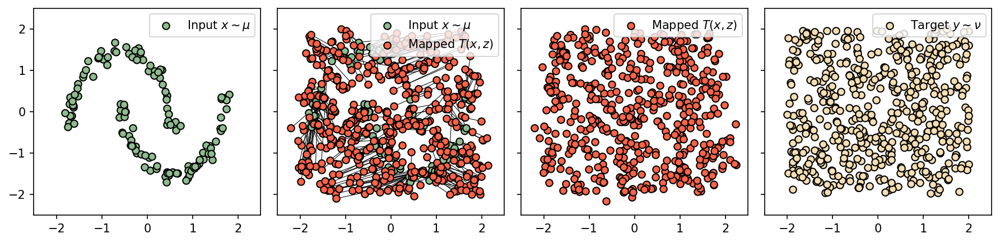

Step 9850
T_loss 0.8516362905502319
f_loss 0.030542343854904175
gamma=1.0


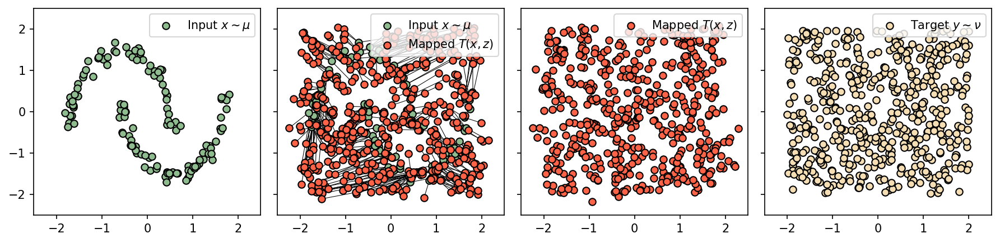

Step 9900
T_loss 0.838154673576355
f_loss -0.08080008625984192
gamma=1.0


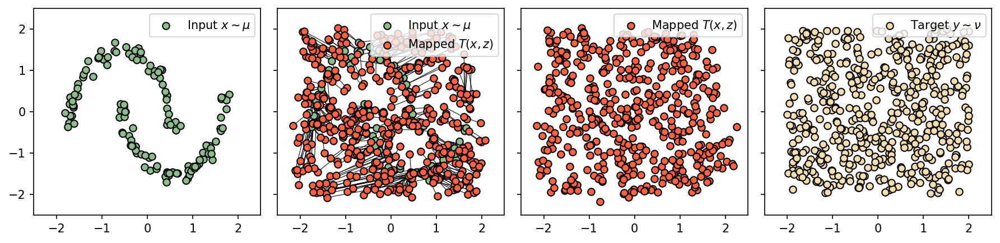

Step 9950
T_loss 0.8520662188529968
f_loss 0.007449030876159668
gamma=1.0


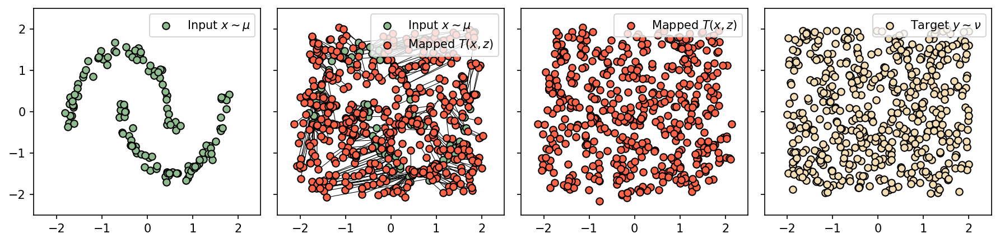

In [12]:
print("WEAK KERNEL COST")
torch.manual_seed(1)

model_T = ModelT().to(DEVICE)
model_f = Modelf().to(DEVICE)

optim_T = torch.optim.Adam(model_T.parameters(), lr=1e-4, weight_decay=1e-10)
optim_f = torch.optim.Adam(model_f.parameters(), lr=1e-4, weight_decay=1e-10)

train(model_T, model_f, optim_T, optim_f,max_steps=10000, dataset=dataset, T_iters=10, batch_size=64, z_size=z_size, cost_function=weak_kernel_cost, XZ_fixed=XZ_fixed, X_fixed=X_fixed, Y_fixed=Y_fixed,gamma=1.0)

# Change gamma and cost

gamma 0.0
cost <function weak_kernel_cost at 0x7f12723467a0>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss -0.1224408745765686
f_loss -0.13239920139312744
gamma=0.0


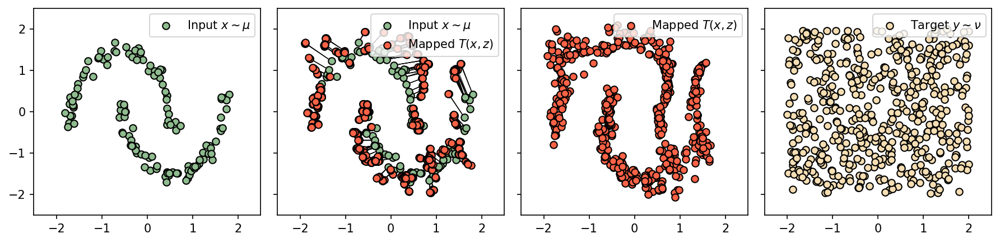

Step 6000
T_loss -0.16761577129364014
f_loss -0.24892950057983398
gamma=0.0


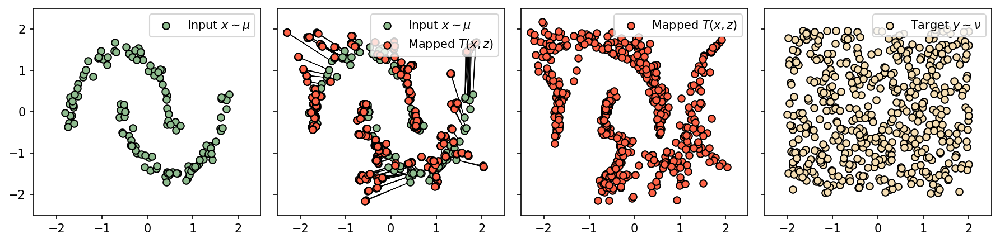

Step 7000
T_loss -0.15920203924179077
f_loss 0.09219813346862793
gamma=0.0


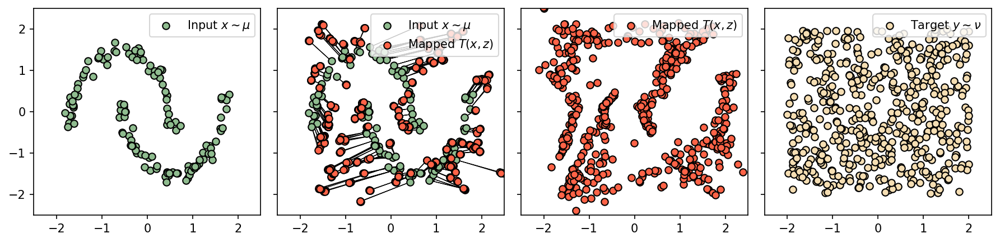

Step 8000
T_loss -0.16351020336151123
f_loss -0.09417098760604858
gamma=0.0


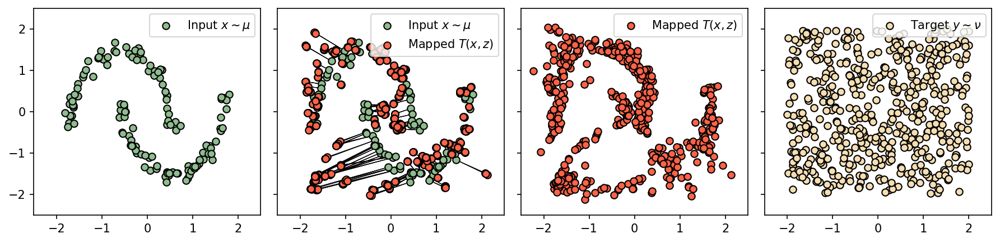

Step 9000
T_loss -0.16312742233276367
f_loss 0.2823532223701477
gamma=0.0


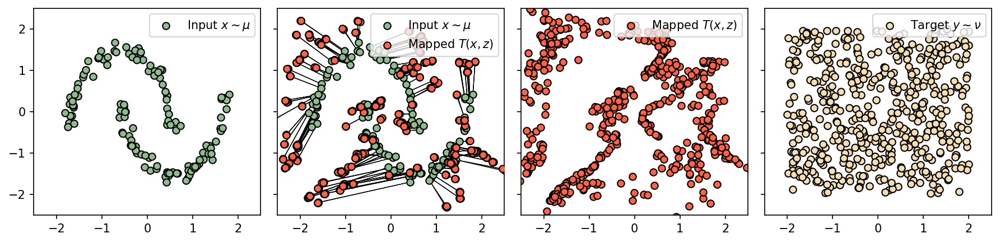

gamma=0.0


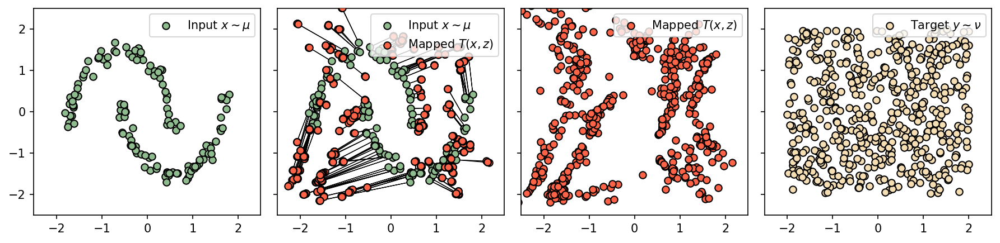

cost <function weak_sq_cost at 0x7f1272346680>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss -0.13227108120918274
f_loss 0.03969660401344299
gamma=0.0


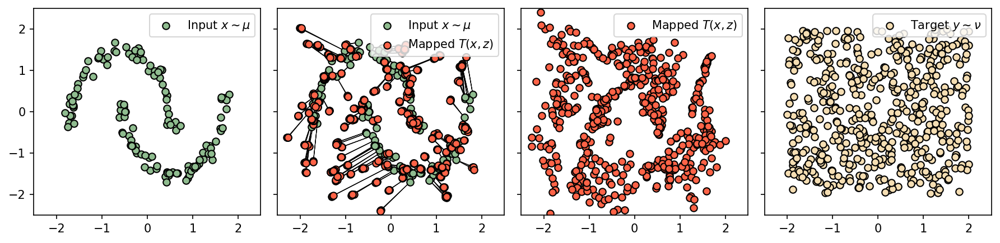

Step 6000
T_loss -0.13974928855895996
f_loss -0.14034050703048706
gamma=0.0


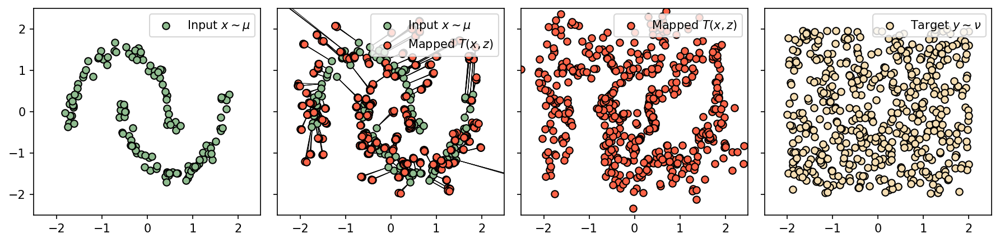

Step 7000
T_loss -0.17640957236289978
f_loss -0.041915178298950195
gamma=0.0


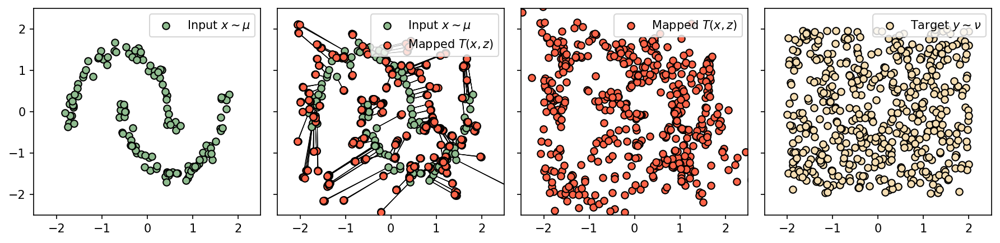

Step 8000
T_loss -0.1263226866722107
f_loss -0.20126047730445862
gamma=0.0


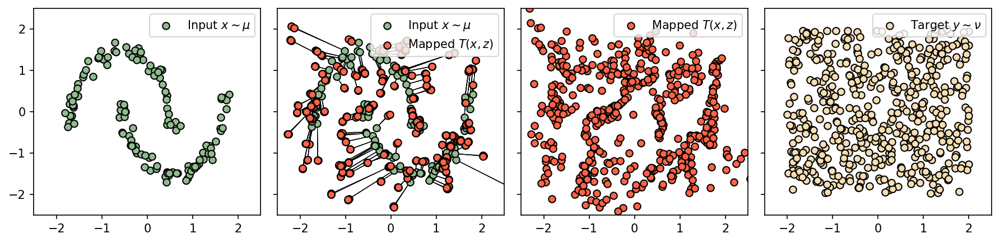

Step 9000
T_loss -0.15720194578170776
f_loss -0.07758575677871704
gamma=0.0


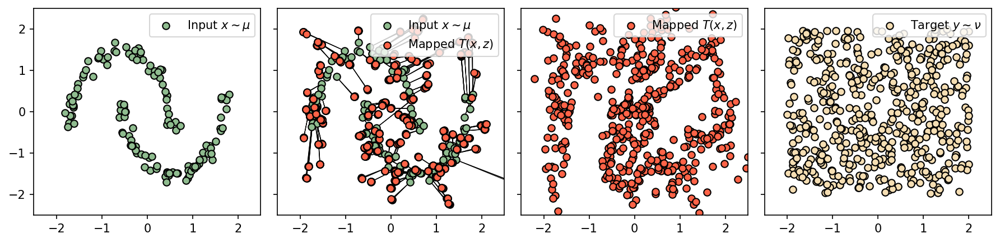

gamma=0.0


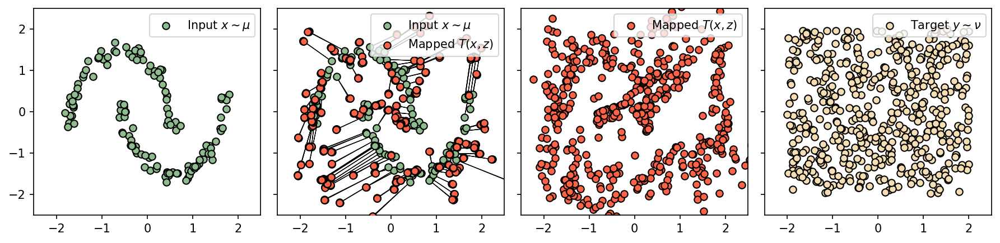

gamma 0.25
cost <function weak_kernel_cost at 0x7f12723467a0>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss 0.12888720631599426
f_loss -0.058886170387268066
gamma=0.25


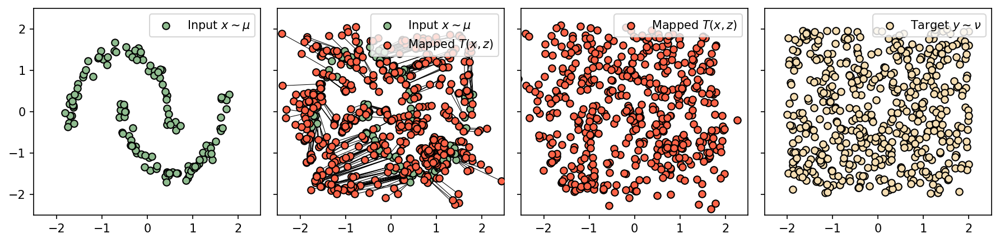

Step 6000
T_loss 0.07977685332298279
f_loss -0.04721689224243164
gamma=0.25


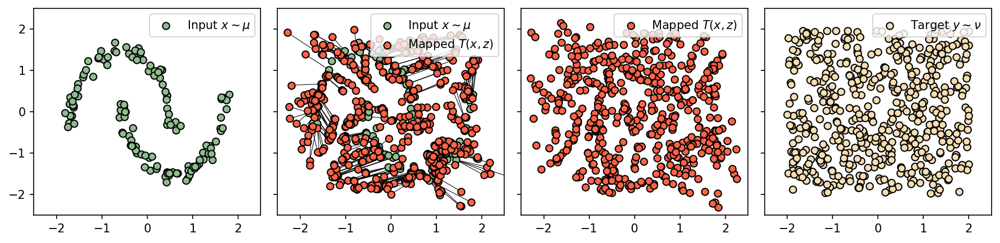

Step 7000
T_loss 0.09076404571533203
f_loss 0.0013350248336791992
gamma=0.25


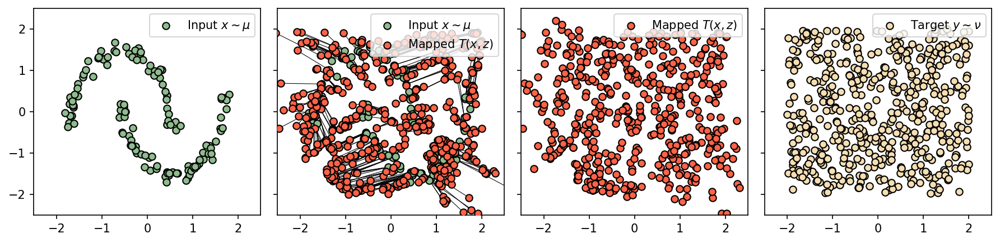

Step 8000
T_loss 0.1269458830356598
f_loss 0.05975073575973511
gamma=0.25


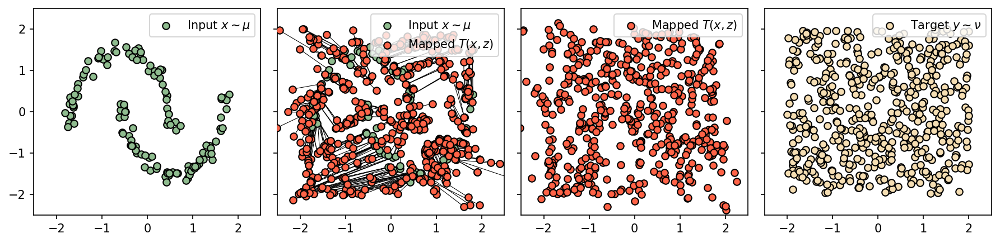

Step 9000
T_loss 0.09125754237174988
f_loss -0.08275312185287476
gamma=0.25


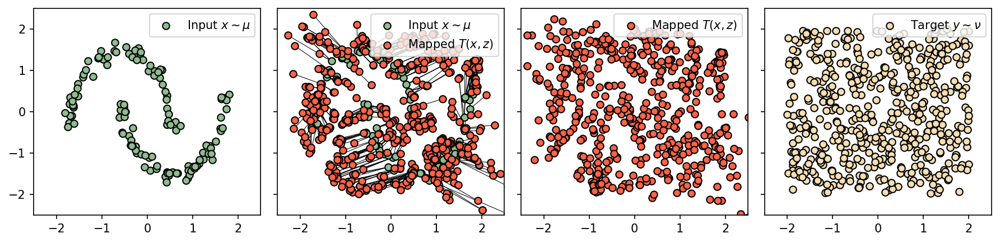

gamma=0.25


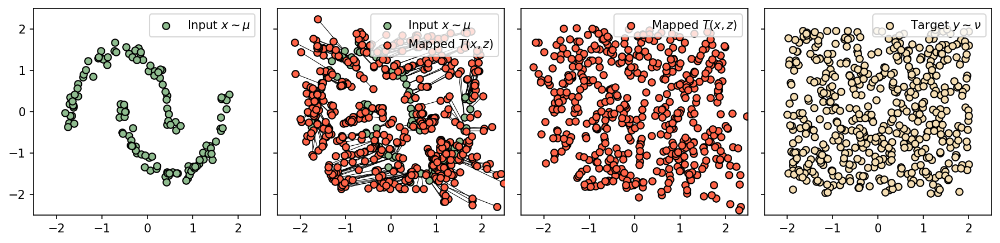

cost <function weak_sq_cost at 0x7f1272346680>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss 0.562723696231842
f_loss 0.04163235425949097
gamma=0.25


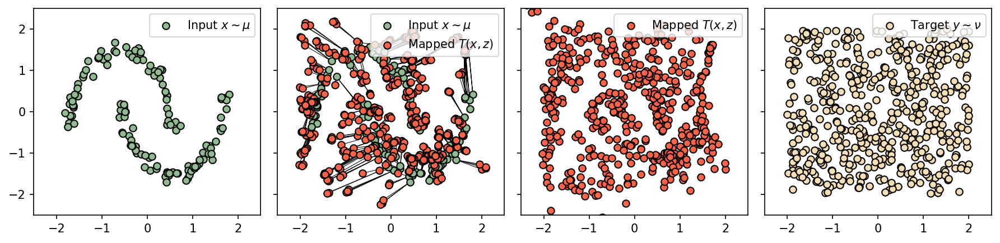

Step 6000
T_loss 0.5542498230934143
f_loss 0.03060568869113922
gamma=0.25


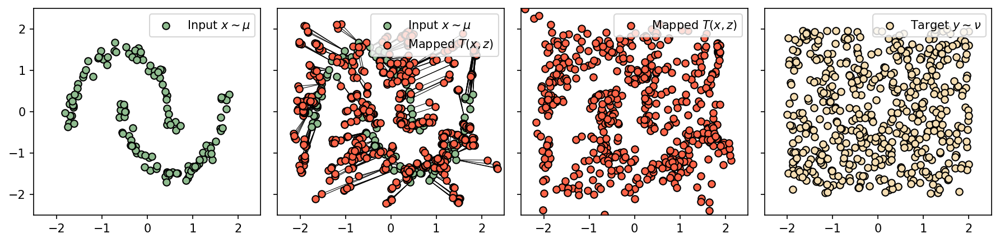

Step 7000
T_loss 0.5473107695579529
f_loss 0.08561674505472183
gamma=0.25


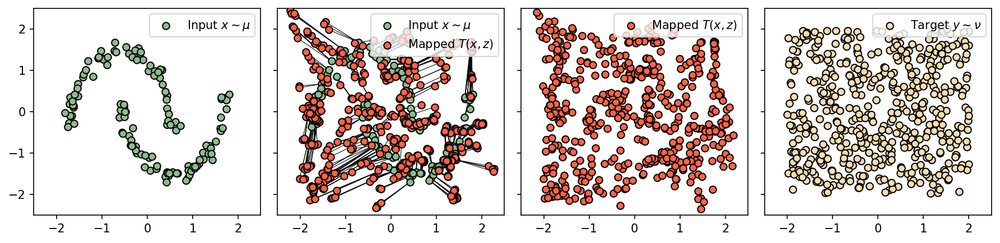

Step 8000
T_loss 0.5338771343231201
f_loss 0.03673473000526428
gamma=0.25


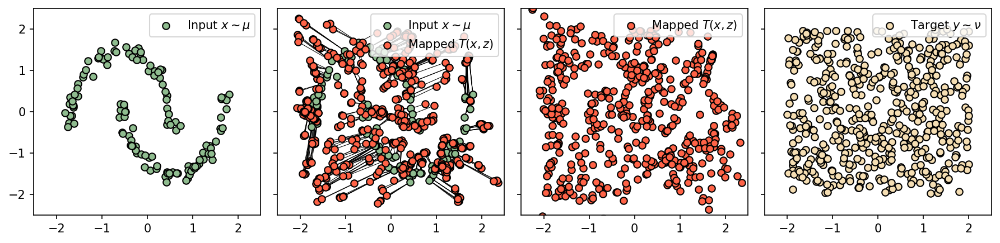

Step 9000
T_loss 0.5156210660934448
f_loss -0.08565523475408554
gamma=0.25


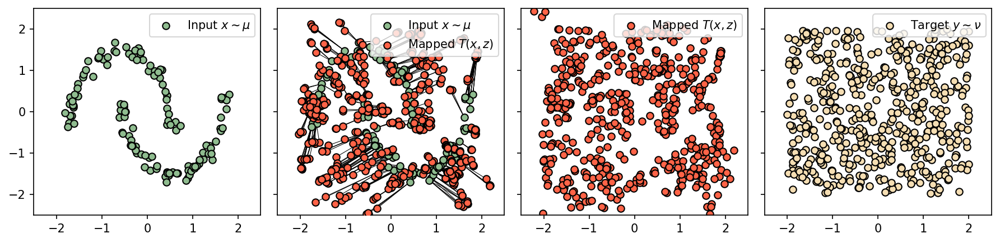

gamma=0.25


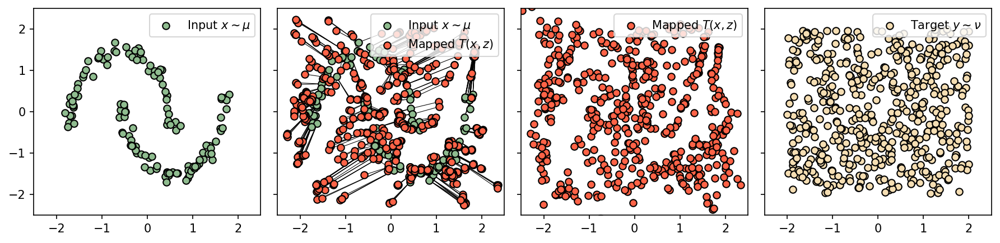

gamma 0.5
cost <function weak_kernel_cost at 0x7f12723467a0>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss 0.3223966360092163
f_loss -0.014372318983078003
gamma=0.5


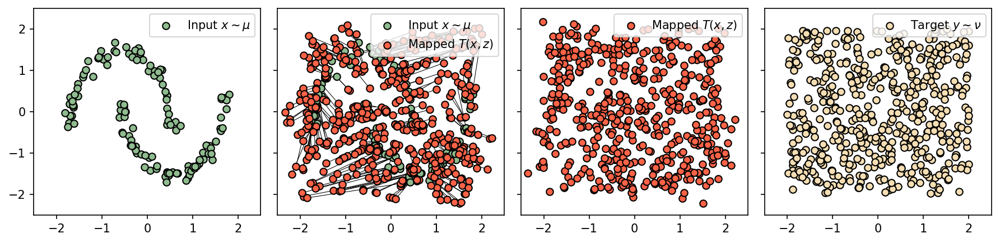

Step 6000
T_loss 0.4098215699195862
f_loss 0.033388540148735046
gamma=0.5


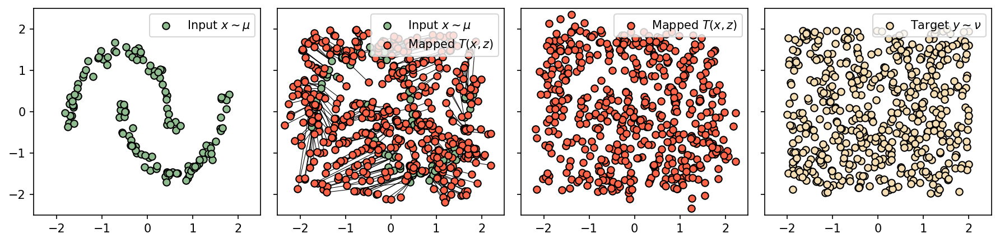

Step 7000
T_loss 0.339398592710495
f_loss -0.015771448612213135
gamma=0.5


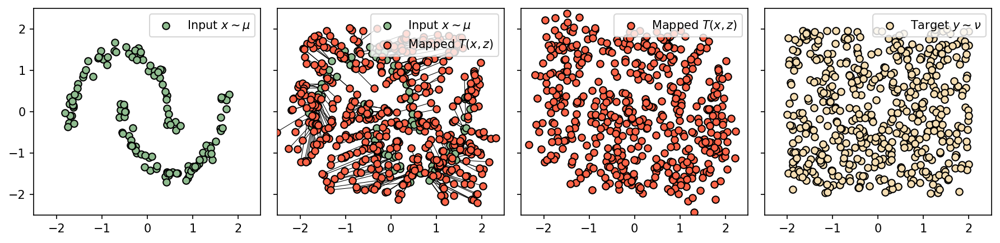

Step 8000
T_loss 0.3482550382614136
f_loss 0.01085139811038971
gamma=0.5


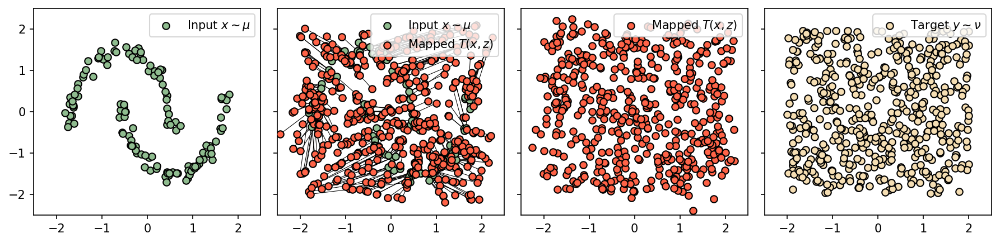

Step 9000
T_loss 0.33458012342453003
f_loss -0.08793692290782928
gamma=0.5


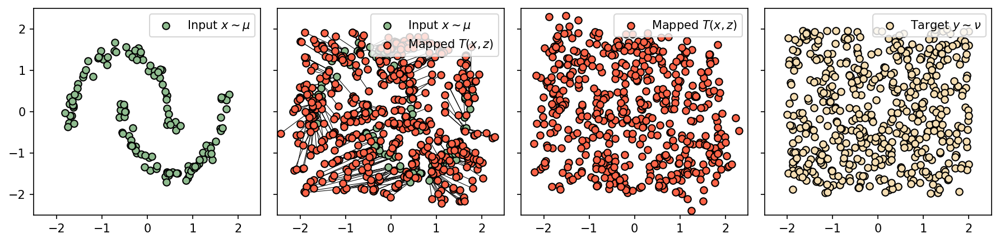

gamma=0.5


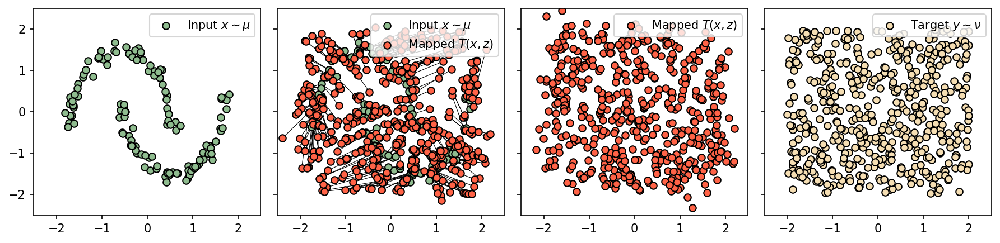

cost <function weak_sq_cost at 0x7f1272346680>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss -0.1411610245704651
f_loss -0.013121277093887329
gamma=0.5


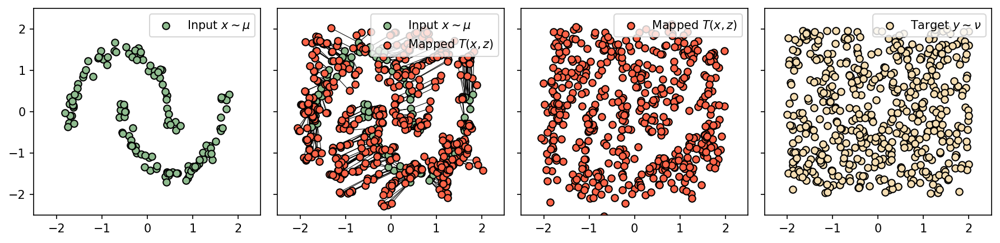

Step 6000
T_loss -0.1507689654827118
f_loss 0.02356216311454773
gamma=0.5


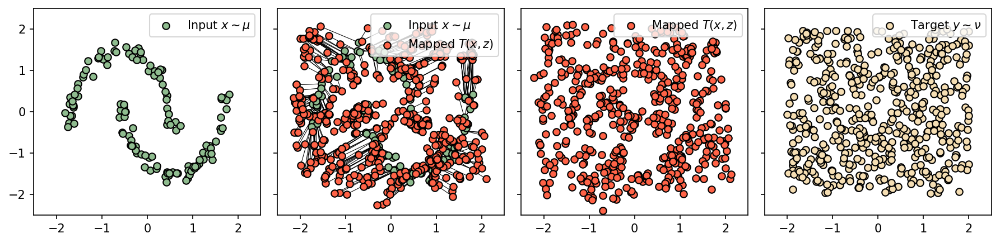

Step 7000
T_loss -0.14430388808250427
f_loss -0.014221340417861938
gamma=0.5


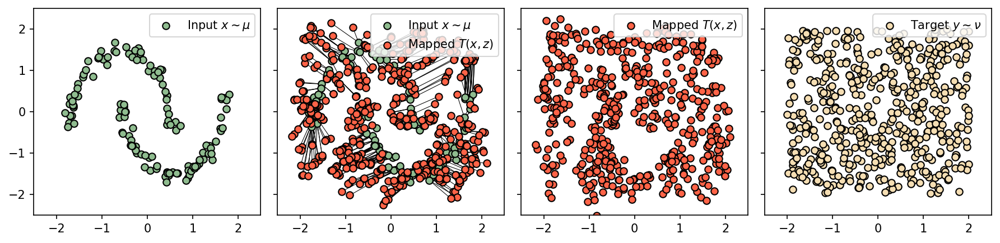

Step 8000
T_loss -0.12138712406158447
f_loss -0.2473112940788269
gamma=0.5


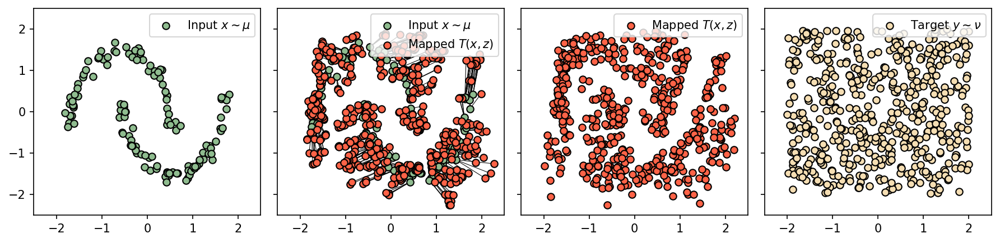

Step 9000
T_loss -0.1029691994190216
f_loss 0.0016853809356689453
gamma=0.5


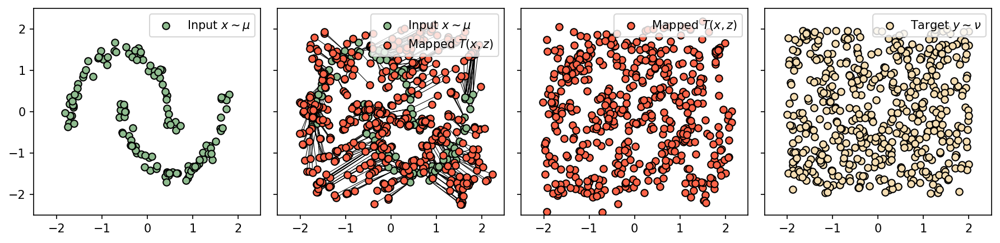

gamma=0.5


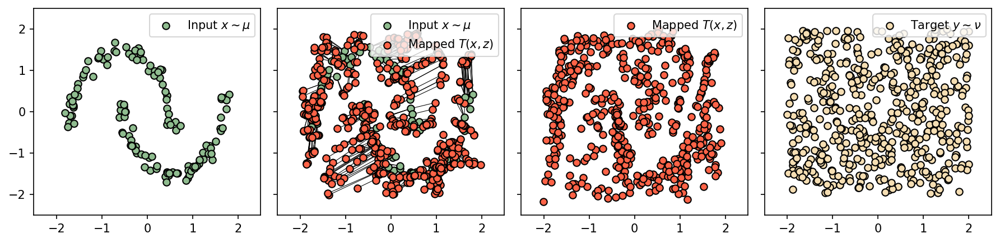

gamma 0.75
cost <function weak_kernel_cost at 0x7f12723467a0>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss 0.05286073684692383
f_loss 0.0077096521854400635
gamma=0.75


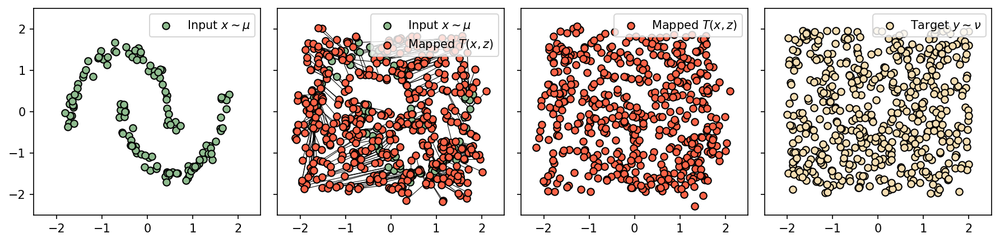

Step 6000
T_loss 0.09006506204605103
f_loss 0.12745878100395203
gamma=0.75


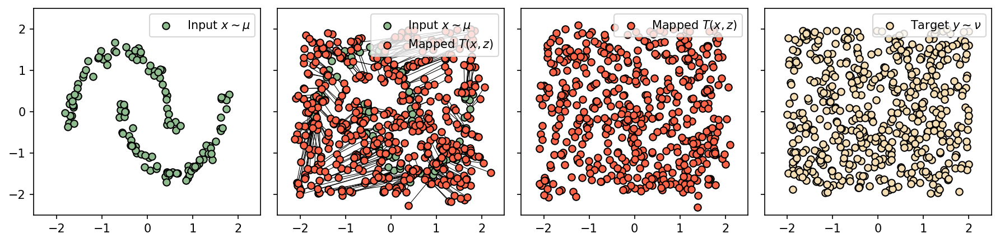

Step 7000
T_loss 0.047685980796813965
f_loss 0.004552751779556274
gamma=0.75


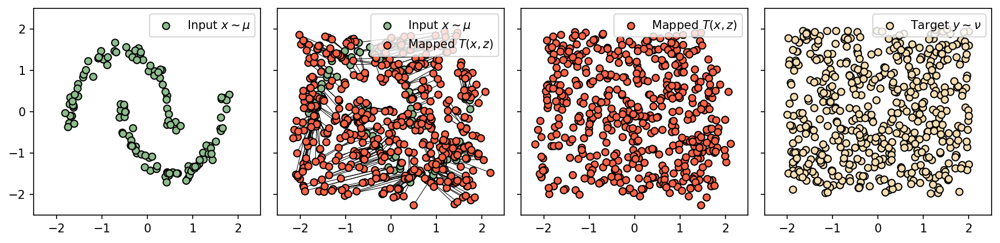

Step 8000
T_loss 0.06213647127151489
f_loss 0.13346099853515625
gamma=0.75


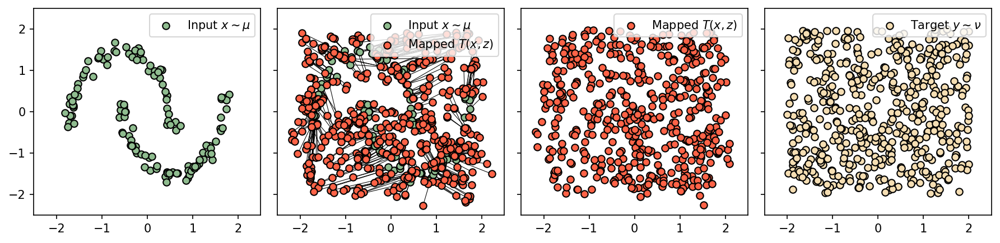

Step 9000
T_loss 0.04862508177757263
f_loss -0.06020048260688782
gamma=0.75


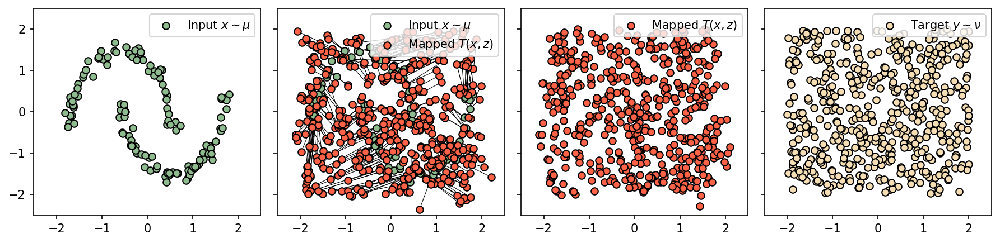

gamma=0.75


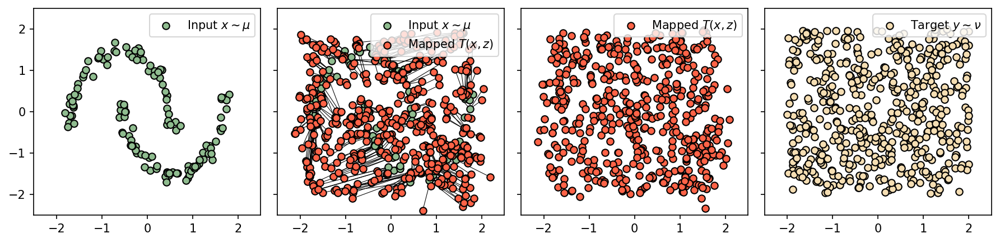

cost <function weak_sq_cost at 0x7f1272346680>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss -0.37104296684265137
f_loss -0.05396544933319092
gamma=0.75


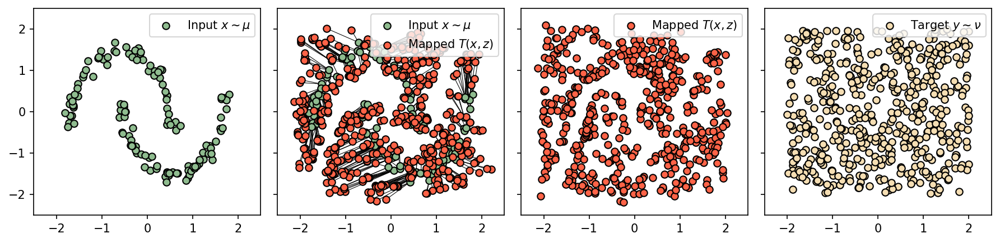

Step 6000
T_loss -0.3536491096019745
f_loss 0.13941508531570435
gamma=0.75


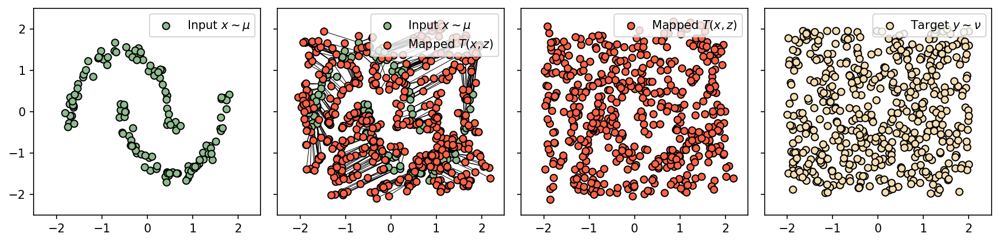

Step 7000
T_loss -0.3625902533531189
f_loss 0.16790896654129028
gamma=0.75


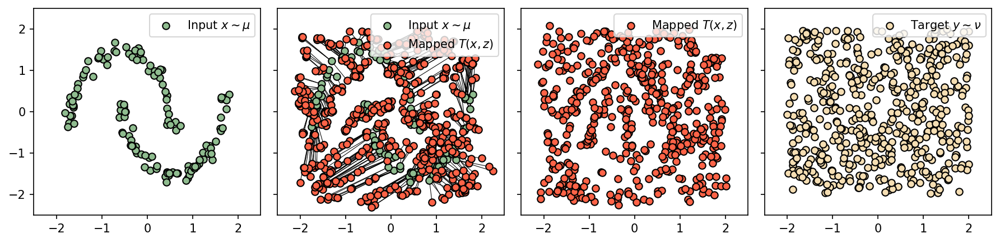

Step 8000
T_loss -0.35781046748161316
f_loss 0.08547449111938477
gamma=0.75


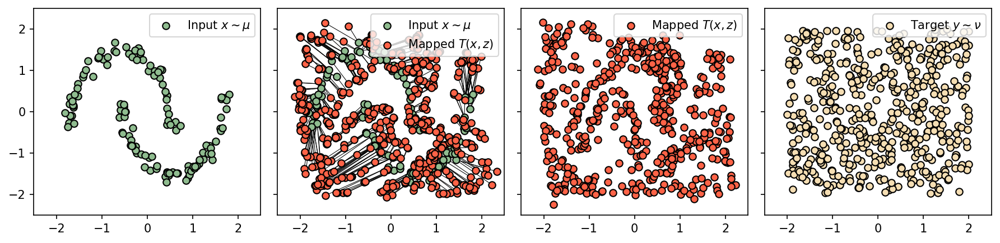

Step 9000
T_loss -0.3001049757003784
f_loss -0.056572914123535156
gamma=0.75


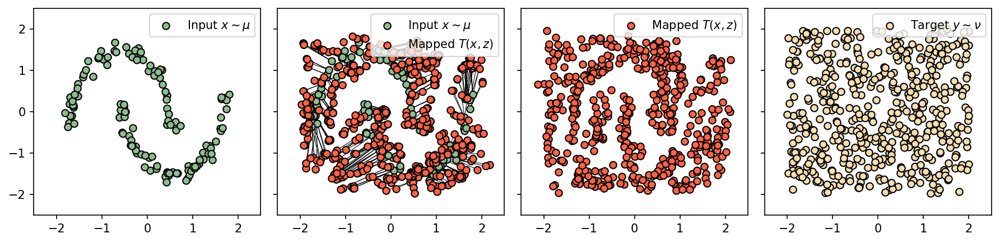

gamma=0.75


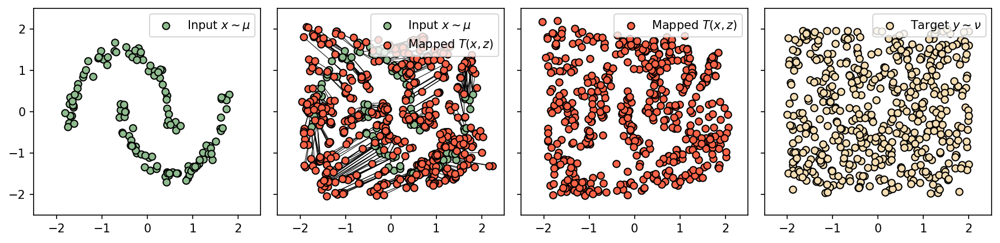

gamma 1
cost <function weak_kernel_cost at 0x7f12723467a0>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss 0.1630488783121109
f_loss 0.01712450385093689
gamma=1


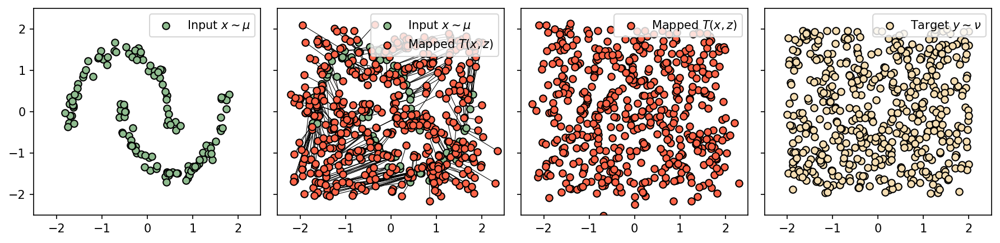

Step 6000
T_loss 0.177315354347229
f_loss -0.025189951062202454
gamma=1


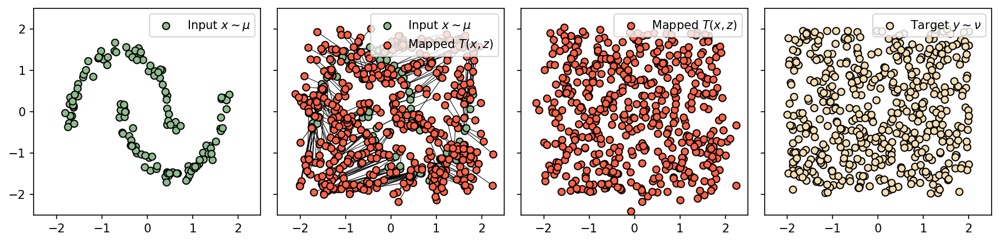

Step 7000
T_loss 0.19557204842567444
f_loss -0.00892840325832367
gamma=1


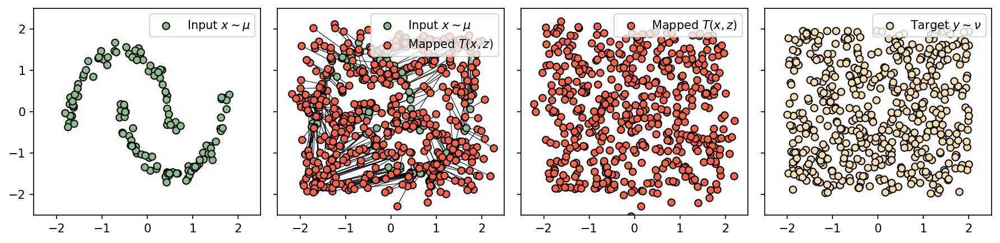

Step 8000
T_loss 0.1768418550491333
f_loss -0.0927947610616684
gamma=1


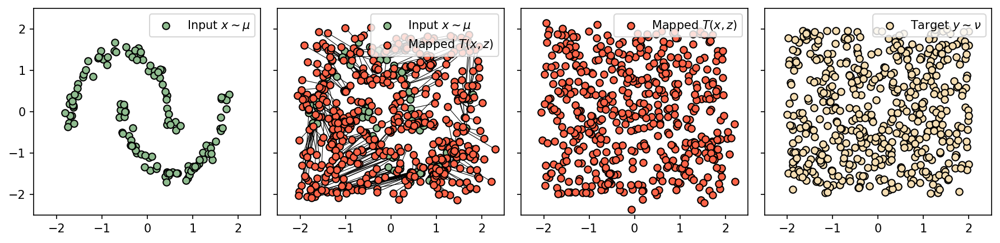

Step 9000
T_loss 0.17504790425300598
f_loss -0.012956857681274414
gamma=1


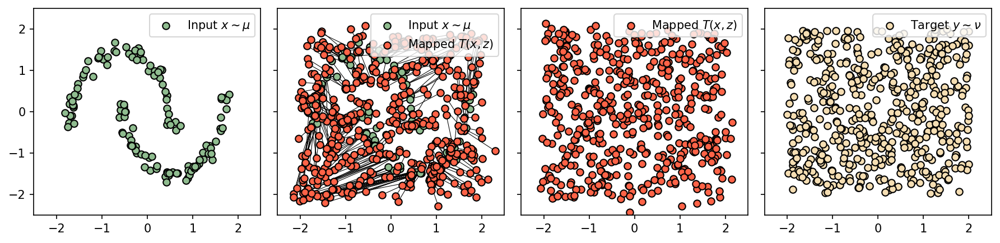

gamma=1


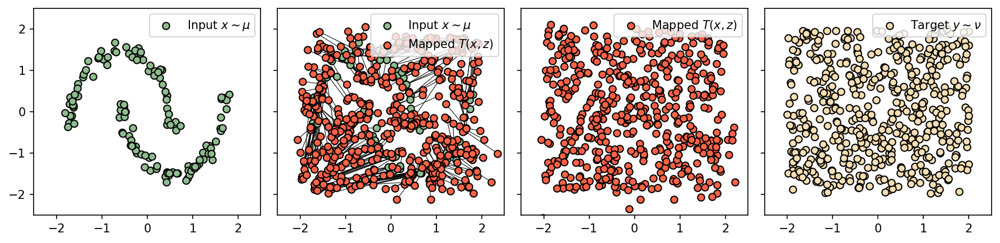

cost <function weak_sq_cost at 0x7f1272346680>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss -0.6749701499938965
f_loss -0.05756962299346924
gamma=1


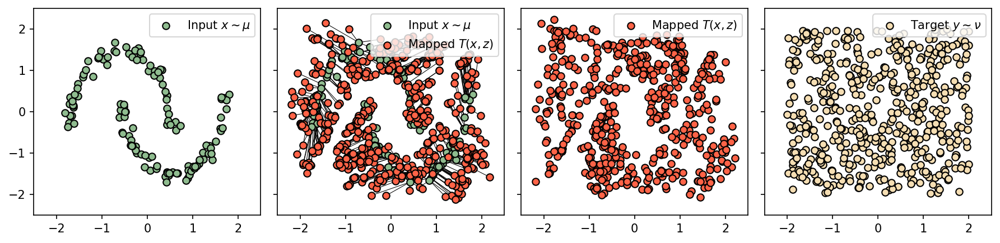

Step 6000
T_loss -0.7207905054092407
f_loss -0.04956483840942383
gamma=1


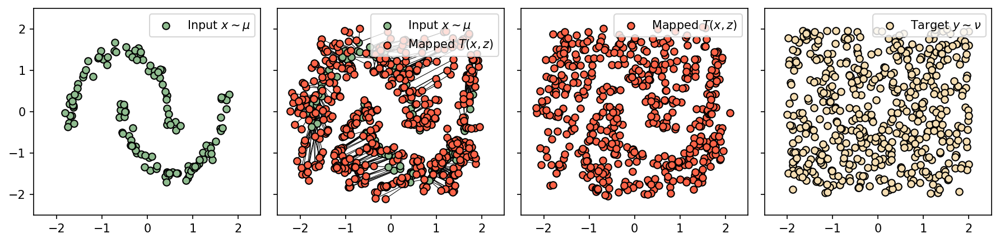

Step 7000
T_loss -0.6487396955490112
f_loss -0.12543421983718872
gamma=1


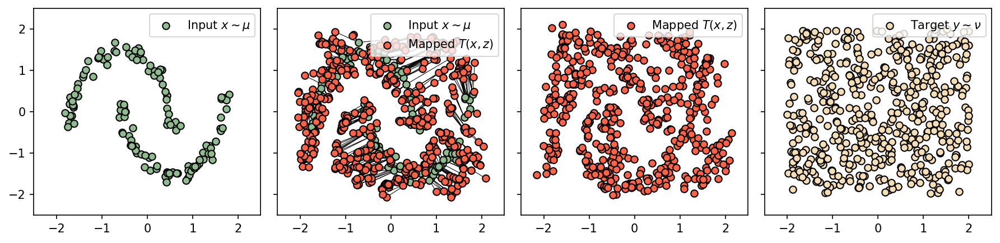

Step 8000
T_loss -0.6764386892318726
f_loss -0.033764541149139404
gamma=1


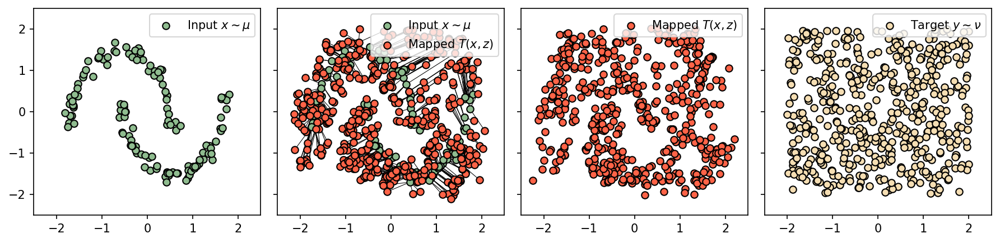

Step 9000
T_loss -0.7426145076751709
f_loss 0.053872525691986084
gamma=1


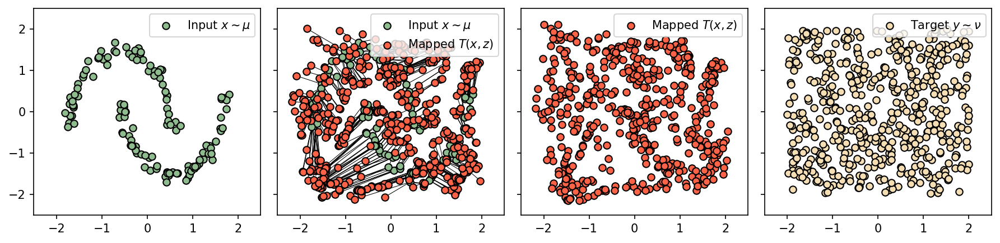

gamma=1


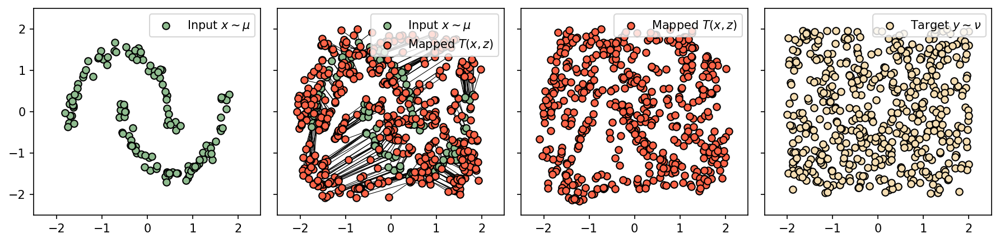

gamma 1.25
cost <function weak_kernel_cost at 0x7f12723467a0>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss 0.44331270456314087
f_loss -0.036938175559043884
gamma=1.25


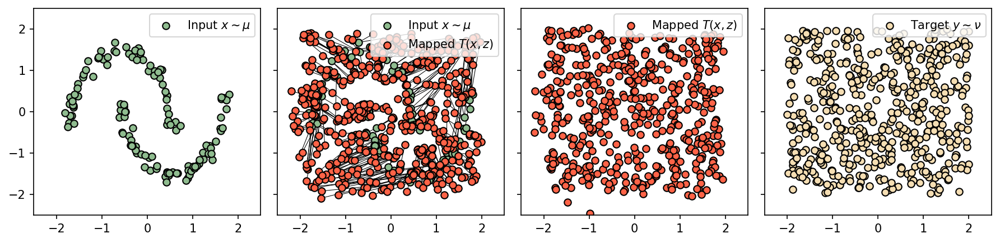

Step 6000
T_loss 0.43485215306282043
f_loss 0.0805349126458168
gamma=1.25


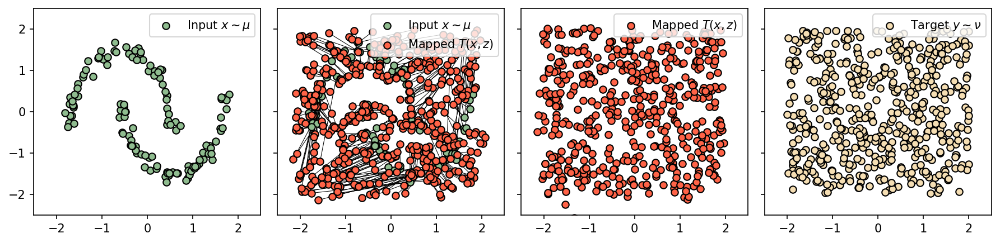

Step 7000
T_loss 0.3791213631629944
f_loss 0.004668973386287689
gamma=1.25


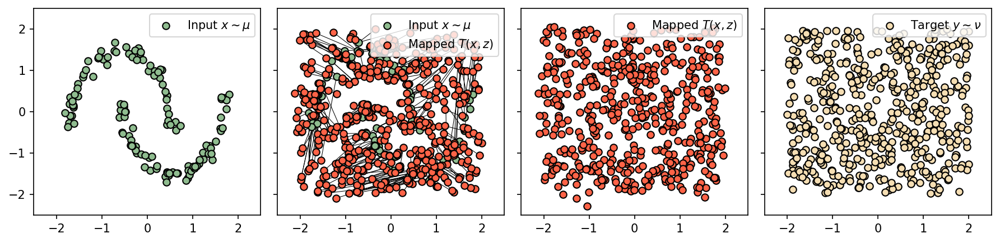

Step 8000
T_loss 0.42454734444618225
f_loss 0.022252388298511505
gamma=1.25


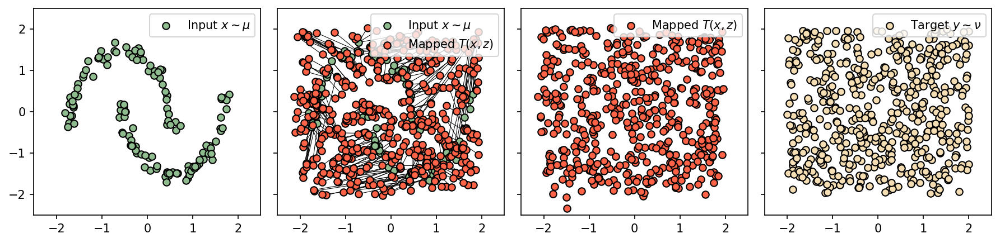

Step 9000
T_loss 0.42174676060676575
f_loss 0.07078015804290771
gamma=1.25


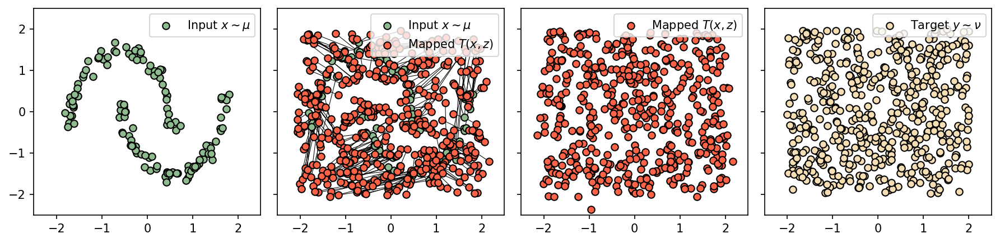

gamma=1.25


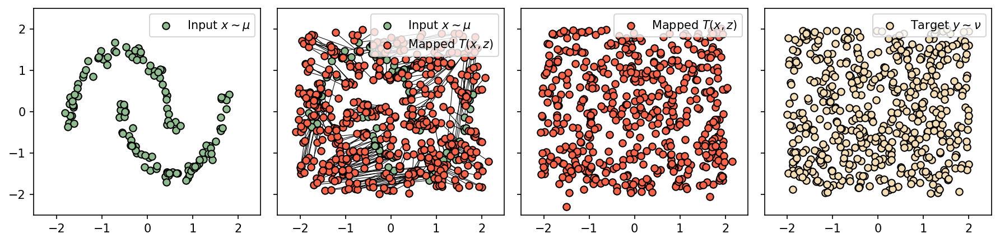

cost <function weak_sq_cost at 0x7f1272346680>


  0%|          | 0/10000 [00:00<?, ?it/s]

Step 5000
T_loss 0.09266592562198639
f_loss -0.03889119625091553
gamma=1.25


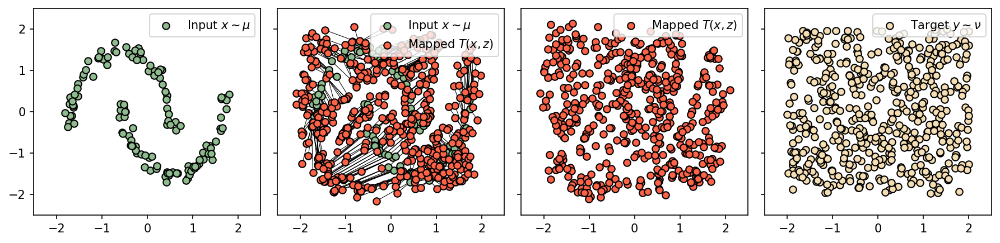

Step 6000
T_loss 0.006983846426010132
f_loss -0.004725754261016846
gamma=1.25


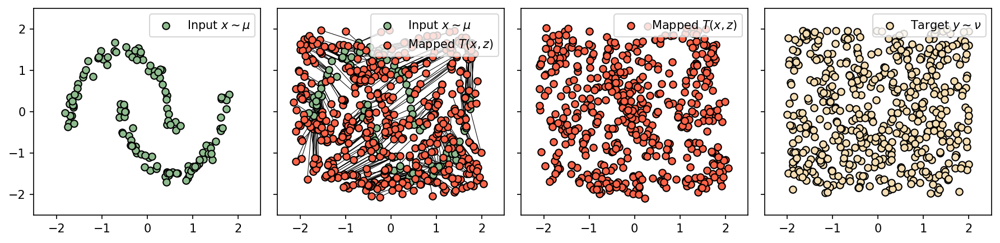

Step 7000
T_loss -0.010604172945022583
f_loss -0.06764820218086243
gamma=1.25


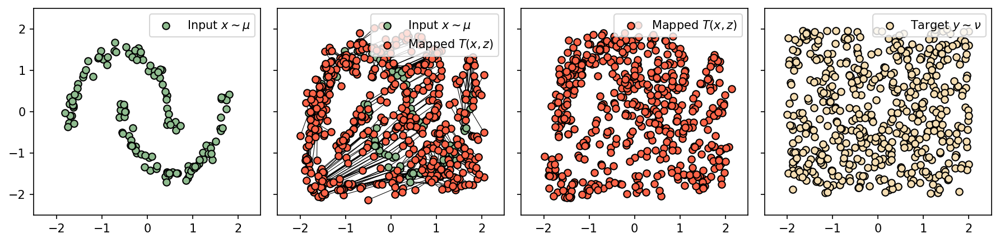

Step 8000
T_loss 0.06374132633209229
f_loss 0.013831563293933868
gamma=1.25


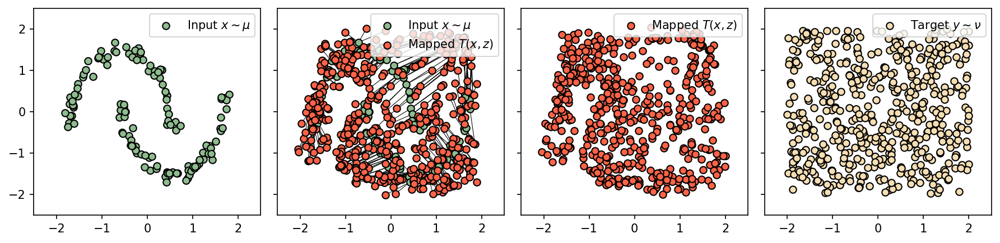

Step 9000
T_loss -0.027617841958999634
f_loss -0.06144776940345764
gamma=1.25


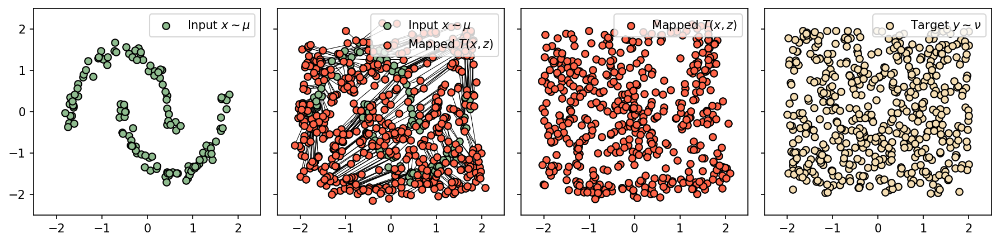

gamma=1.25


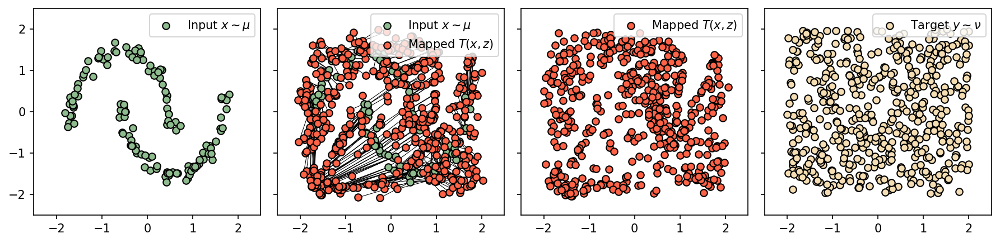

In [20]:
gammas = [0.,0.25,0.5,0.75,1,1.25]
costs = [weak_kernel_cost,weak_sq_cost]


for gamma in gammas:
    print(f"gamma {gamma}")
    for cost in costs:
        print(f"cost {cost}")
    
        model_T = ModelT().to(DEVICE)
        model_f = Modelf().to(DEVICE)

        optim_T = torch.optim.Adam(model_T.parameters(), lr=1e-4, weight_decay=1e-10)
        optim_f = torch.optim.Adam(model_f.parameters(), lr=1e-4, weight_decay=1e-10)

        train(model_T, model_f, optim_T, optim_f,max_steps=10000, dataset=dataset, T_iters=10, batch_size=64, z_size=z_size, cost_function=cost, XZ_fixed=XZ_fixed, X_fixed=X_fixed, Y_fixed=Y_fixed,gamma=gamma)
        plot_results(gamma, XZ_fixed, X_fixed, Y_fixed, model_T,z_size)